### Runs our trained U-Net based model on test dataset and save results


Runing on: cuda
Train images: 96 (augmentation: True)
Test images: 24 (augmentation: False)
Model loaded on: cuda

1-original 2019-10-31 01:35:37.448435
	Batch 1: 1/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:37.626116
	Batch 2: 2/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:38.788058
	Batch 3: 3/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:39.269884
	Batch 4: 4/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:39.720057
	Batch 5: 5/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:40.236222
	Batch 6: 6/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:40.796558
	Batch 7: 7/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:41.263073
	Batch 8: 8/24 images: torch.Size([1, 3, 256, 448]) masks: tor

/anaconda/envs/py35/lib/python3.5/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


	Batch 22: 22/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:48.464485
	Batch 23: 23/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:48.931874
	Batch 24: 24/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:35:49.384826
Train images: 96 (augmentation: True)
Test images: 24 (augmentation: False)
Model loaded on: cuda

2-khan_et_al 2019-10-31 01:36:09.882683
	Batch 1: 1/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:36:09.985800
	Batch 2: 2/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:36:10.392458
	Batch 3: 3/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:36:10.827184
	Batch 4: 4/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:36:11.354376
	Batch 5: 5/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([

	Batch 19: 19/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:37:22.829448
	Batch 20: 20/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:37:23.311496
	Batch 21: 21/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:37:23.820621
	Batch 22: 22/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:37:24.282806
	Batch 23: 23/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:37:24.768682
	Batch 24: 24/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:37:25.247773
Train images: 96 (augmentation: True)
Test images: 24 (augmentation: False)
Model loaded on: cuda

5-reinhard_et_al 2019-10-31 01:37:42.887880
	Batch 1: 1/24 images: torch.Size([1, 3, 256, 448]) masks: torch.Size([1, 256, 448]) 2019-10-31 01:37:43.065466
	Batch 2: 2/24 images: torch.Size([1, 3, 256, 448]) masks: to

FileNotFoundError: [Errno 2] No such file or directory: 'UNet_IN-3_OUT-1_UPMODE-ConvTranspose__Dataset-6-vahadane_et_al__Epoch-500__Size-448x256.pt'

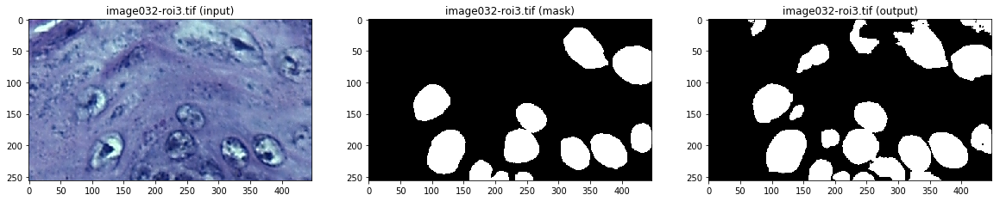

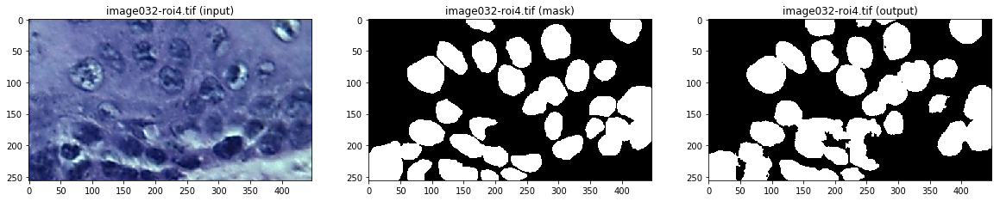

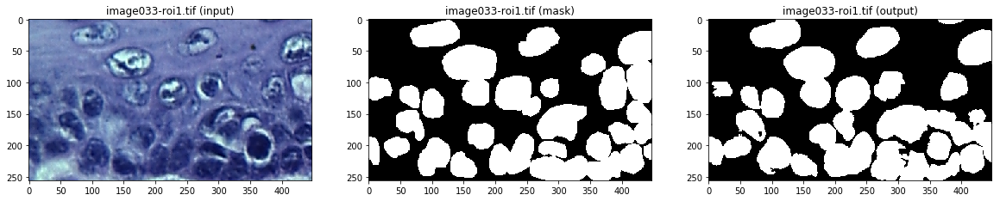

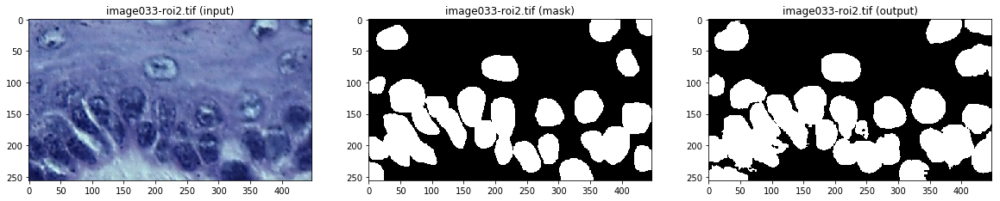

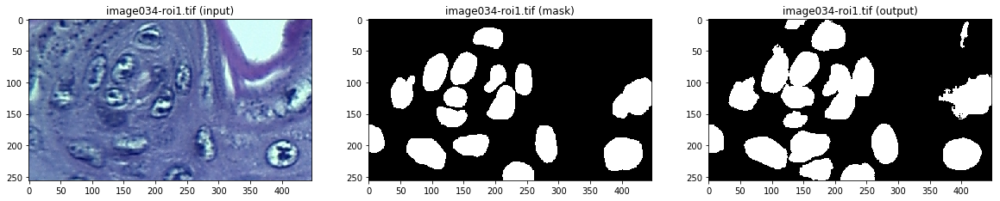

...

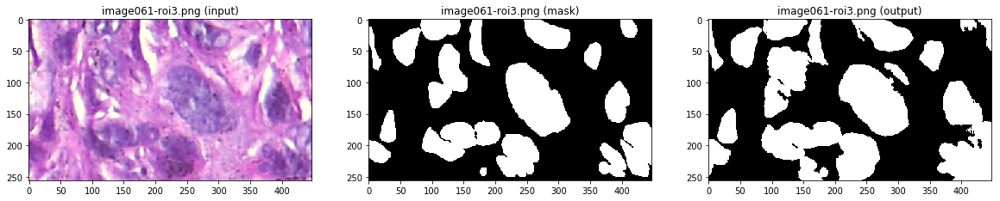

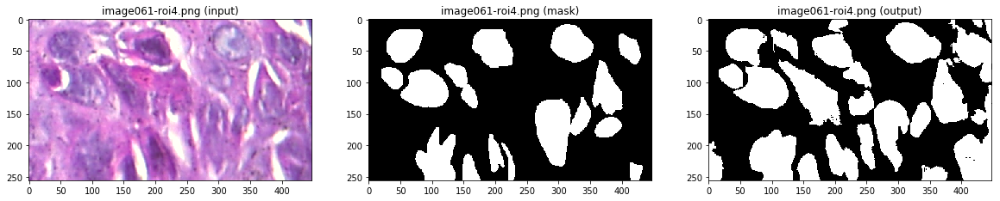

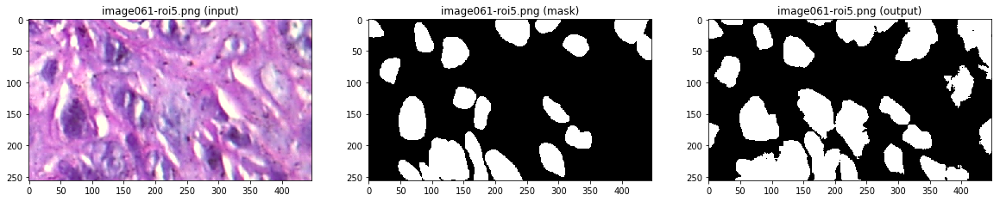

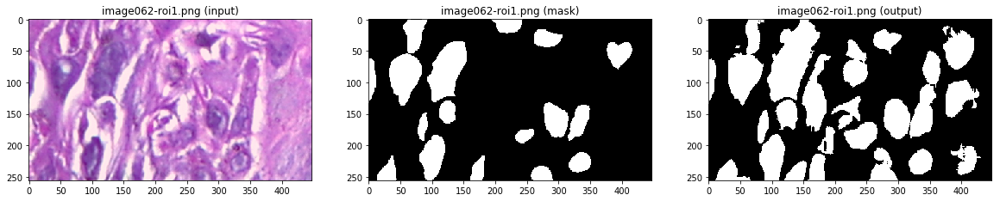

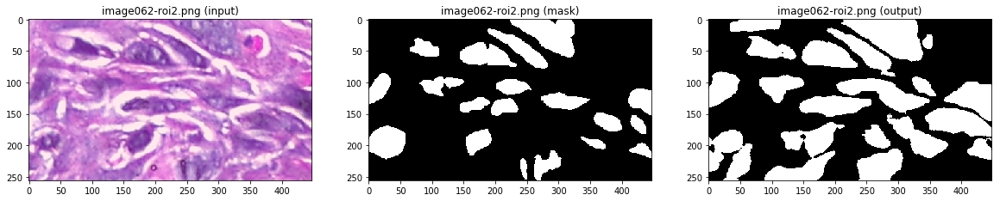

In [1]:
from unet_model import *
from oral_mice_tissues_dataset import *

from torchvision import transforms
from torchvision import utils
from torch.autograd import Variable

from datetime import datetime
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np


# Checking for GPU availability
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print()
print('Runing on: {}'.format(device))

color_norm_methods = ["1-original", "2-khan_et_al", "3-macenko_et_al", "4-tosta_et_al", "5-reinhard_et_al", "6-vahadane_et_al"]
for color_normalization in color_norm_methods:

    # create the datasets
    batch_size = 1
    dataset_dir = "/home/dalifreire/notebooks/github/histological_oral_mice_tissues/roi"
    dataloaders = create_dataloader(method=color_normalization, batch_size=batch_size, dataset_dir=dataset_dir)


    # directory to save results
    seg_method = "1-unet_based"
    results_dir = "results/{}/{}".format(color_normalization, seg_method)
    if not os.path.exists(results_dir):
        os.makedirs(results_dir)


    # load the trained model
    epoch = 500
    model = UNet(in_channels=3, out_channels=1, padding=True).to(device)
    model = load_checkpoint(file_path="{}__Dataset-{}__Epoch-{}__Size-448x256.pt".format(model.name(), color_normalization, epoch))
    print()

    # iterate over test dataset images        
    t1 = datetime.now()
    print("{} {}".format(color_normalization, t1))
    for batch_idx, (images, masks, fname, original_size) in enumerate(dataloaders['test']):

        t = datetime.now()

        X = Variable(images.to(device))
        print('\tBatch {}: {}/{} images: {} masks: {} {}'.format(
            (batch_idx+1), 
            (batch_idx+1) * len(images), 
            len(dataloaders['test'].dataset),
            images.shape,
            masks.shape,
            datetime.now()))


        y_hat = model(X).squeeze(0)
        X_numpy = X.cpu().numpy()
        y_hat_numpy = y_hat.detach().cpu().numpy()


        input_image_filename  = '{}/{} - input.png'.format(results_dir, fname[0][0:-4])
        mask_image_filename   = '{}/{} - mask.png'.format(results_dir, fname[0][0:-4])
        output_image_filename = '{}/{} - output - 1.png'.format(results_dir, fname[0][0:-4])
        output_image_filename_otsu  = '{}/{} - output - 2 - otsu.png'.format(results_dir, fname[0][0:-4])
        output_image_filename_hyst  = '{}/{} - output - 3 - hysteresis.png'.format(results_dir, fname[0][0:-4])
        output_image_filename_basic = '{}/{} - output - 4 - basic.png'.format(results_dir, fname[0][0:-4])
        f, ax = plt.subplots(1, 3, figsize=(20, 20))


        # save the input image
        input_image = images[0]
        utils.save_image(input_image, input_image_filename)
        ax[0].imshow(input_image.permute(1, 2, 0))
        ax[0].set_title('{} (input)'.format(fname[0]))

        # save the mask image
        mask_image = masks[0]
        utils.save_image(mask_image, mask_image_filename)
        ax[1].imshow(mask_image, cmap='gray')
        ax[1].set_title('{} (mask)'.format(fname[0]))

        # save the predicted output image
        output_image = y_hat[0].squeeze(0).detach().cpu().numpy()
        output_image_otsu  = otsu_threshold(np_img=output_image)
        output_image_hyst  = hysteresis_threshold(np_img=output_image, low=0.2, high=0.8)
        output_image_basic = basic_threshold(np_img=output_image, threshold=0.2)

        utils.save_image(y_hat[0], output_image_filename)
        utils.save_image(TF.to_tensor(np_to_pil(output_image_otsu)), output_image_filename_otsu)
        utils.save_image(TF.to_tensor(np_to_pil(output_image_hyst)), output_image_filename_hyst)
        utils.save_image(TF.to_tensor(np_to_pil(output_image_basic)), output_image_filename_basic)

        ax[2].imshow(output_image_hyst, cmap='gray')
        ax[2].set_title('{} (output)'.format(fname[0]))
        

### Qualitative analysis

In [2]:
from torchvision import utils
from torchvision import transforms
from image_utils import *
from experimental_evaluation import *

import os
import csv
import collections

color_norm_methods = ["1-original", "2-khan_et_al", "3-macenko_et_al", "4-tosta_et_al", "5-reinhard_et_al", "6-vahadane_et_al"]
seg_methods = ["1-unet_based", "2-de_oliveira_et_al_(2013)", "3-phoulady_et_al_(2016)", "4-vahadane_and_sethi_(2013)", "5-wienert_et_al_(2012)"]
results_dir = "/home/dalifreire/notebooks/github/dysplastic_oral_tissues_segmentation/results"
#results_dir = "/home/dalifreire/Documents/Doutorado/github/dysplastic_oral_tissues_segmentation/results"

for r, d, f in sorted(os.walk(results_dir)):
    for norm_method in sorted(color_norm_methods):
        if (r.endswith(norm_method)):
            
            print(r)
            for seg_method in sorted(seg_methods):
                
                print("\t{}".format(seg_method))
                seg_method_dir = "{}/{}".format(r, seg_method)
                
                for r_seg, d_seg, f_sef in sorted(os.walk(seg_method_dir)):
                    for file in sorted(f_sef):
                        
                        threshold_type = "output - 2 - otsu.png" if seg_method == "1-unet_based" else "output.png"
                        if file.lower().endswith(threshold_type):
                            
                            input_filename = "{}/{}/{}".format(r, "1-unet_based", file.replace(threshold_type, 'input.png'))
                            mask_filename = "{}/{}/{}".format(r, "1-unet_based", file.replace(threshold_type, 'mask.png'))
                            output_filename = "{}/{}/{}".format(r, seg_method, file)

                            input_image = load_pil_image(input_filename)
                            mask_image = load_pil_image(mask_filename, gray=True)
                            output_image = load_pil_image(output_filename, gray=True)

                            
                            merge_image_output_b = cut_image_by_mask(input_image, output_image, inverse=True)
                            merge_image_mask_b = cut_image_by_mask(input_image, mask_image, inverse=True)

                            merge_image_output_f = cut_image_by_mask(input_image, output_image, inverse=False)
                            merge_image_mask_f = cut_image_by_mask(input_image, mask_image, inverse=False)

                                                        
                            utils.save_image(transforms.ToTensor()(merge_image_output_f), output_filename.replace(".png", "_2.png"))
                            utils.save_image(transforms.ToTensor()(merge_image_mask_f), output_filename.replace(".png", "_3.png"))
                            
                            utils.save_image(transforms.ToTensor()(merge_image_output_b), output_filename.replace(".png", "_4.png"))
                            utils.save_image(transforms.ToTensor()(merge_image_mask_b), output_filename.replace(".png", "_5.png"))


/home/dalifreire/notebooks/github/dysplastic_oral_tissues_segmentation/results/1-original
	1-unet_based
	2-de_oliveira_et_al_(2013)
	3-phoulady_et_al_(2016)
	4-vahadane_and_sethi_(2013)
	5-wienert_et_al_(2012)
/home/dalifreire/notebooks/github/dysplastic_oral_tissues_segmentation/results/2-khan_et_al
	1-unet_based
	2-de_oliveira_et_al_(2013)
	3-phoulady_et_al_(2016)
	4-vahadane_and_sethi_(2013)
	5-wienert_et_al_(2012)
/home/dalifreire/notebooks/github/dysplastic_oral_tissues_segmentation/results/3-macenko_et_al
	1-unet_based
	2-de_oliveira_et_al_(2013)
	3-phoulady_et_al_(2016)
	4-vahadane_and_sethi_(2013)
	5-wienert_et_al_(2012)
/home/dalifreire/notebooks/github/dysplastic_oral_tissues_segmentation/results/4-tosta_et_al
	1-unet_based
	2-de_oliveira_et_al_(2013)
	3-phoulady_et_al_(2016)
	4-vahadane_and_sethi_(2013)
	5-wienert_et_al_(2012)
/home/dalifreire/notebooks/github/dysplastic_oral_tissues_segmentation/results/5-reinhard_et_al
	1-unet_based
	2-de_oliveira_et_al_(2013)
	3-phoulady_

### Quantitative analysis

In [4]:
from torchvision import utils
from image_utils import *
from experimental_evaluation import *

import os
import csv
import collections


color_norm_methods = ["1-original", "2-khan_et_al", "3-macenko_et_al", "4-tosta_et_al", "5-reinhard_et_al", "6-vahadane_et_al"]
seg_methods = ["1-unet_based", "2-de_oliveira_et_al_(2013)", "3-phoulady_et_al_(2016)", "4-vahadane_and_sethi_(2013)", "5-wienert_et_al_(2012)"]
results_dir = "/home/dalifreire/notebooks/github/dysplastic_oral_tissues_segmentation/results"
#results_dir = "/home/dalifreire/Documents/Doutorado/github/dysplastic_oral_tissues_segmentation/results"

for r, d, f in sorted(os.walk(results_dir)):
    for norm_method in sorted(color_norm_methods):
        if (r.endswith(norm_method)):
            
            print(r)
            for seg_method in sorted(seg_methods):
                
                print("\t{}".format(seg_method))
                seg_method_dir = "{}/{}".format(r, seg_method)
                
                if os.path.exists(seg_method_dir):
                    with open('{}/quantitative_analysis.csv'.format(seg_method_dir), mode='w') as medidas_file:
                        medidas_writer = csv.writer(medidas_file, delimiter=',', quotechar='"', quoting=csv.QUOTE_MINIMAL)
                        medidas_writer.writerow(['image', 'accuracy', 'precision', 'f1/dice', 'jaccard', 'sensitivity/recall', 'specificity'])

                        for r_seg, d_seg, f_sef in sorted(os.walk(seg_method_dir)):
                            for file in sorted(f_sef):

                                threshold_type = "output - 2 - otsu.png" if seg_method == "1-unet_based" else "output.png"
                                if file.lower().endswith(threshold_type):

                                    mask_filename = "{}/{}/{}".format(r, "1-unet_based", file.replace(threshold_type, "mask.png"))
                                    output_filename = "{}/{}/{}".format(r, seg_method, file)

                                    accuracy = pixel_accuracy_score(mask_filename, output_filename)
                                    jaccard = jaccard_index_score(mask_filename, output_filename)
                                    precision = precision_score(mask_filename, output_filename)
                                    recall = recall_score(mask_filename, output_filename)
                                    f1 = f1_score(mask_filename, output_filename)
                                    sensitivity = sensitivity_score(mask_filename, output_filename)
                                    specificity = specificity_score(mask_filename, output_filename)
                                    dice = dice_score(mask_filename, output_filename)

                                    print(file.replace(" - " + threshold_type, ""))
                                    print('\t{}: \t\t{}'.format('accuracy', accuracy))
                                    print('\t{}: \t\t{}'.format('precision', precision))
                                    print('\t{}: \t\t{}'.format('f1/dice', f1))
                                    print('\t{}: \t\t{}'.format('jaccard', jaccard))
                                    print('\t{}: \t{}'.format('sensitivity/recall', sensitivity))
                                    print('\t{}: \t\t{}'.format('specificity', specificity))
                                    print()

                                    medidas_writer.writerow([file.replace(" - " + threshold_type, ""), accuracy, precision, f1, jaccard, sensitivity, specificity])

/home/dalifreire/notebooks/github/dysplastic_oral_tissues_segmentation/results/1-original
	1-unet_based
image021-roi5
	accuracy: 		0.9335065569196429
	precision: 		0.9232138618561595
	f1/dice: 		0.9107193031750492
	jaccard: 		0.8360740310827368
	sensitivity/recall: 	0.8985584253569283
	specificity: 		0.9546931458502563

image021-roi6
	accuracy: 		0.87353515625
	precision: 		0.8342563707105051
	f1/dice: 		0.8677920988824677
	jaccard: 		0.7664600273729973
	sensitivity/recall: 	0.9041369092843033
	specificity: 		0.8475660863958736

image023-roi1
	accuracy: 		0.9128766741071429
	precision: 		0.8612081170363379
	f1/dice: 		0.879597050175929
	jaccard: 		0.7850720585072058
	sensitivity/recall: 	0.8987884160756501
	specificity: 		0.9205993520518359

image023-roi2
	accuracy: 		0.8830740792410714
	precision: 		0.8455356603355556
	f1/dice: 		0.862277909006881
	jaccard: 		0.7578985376421736
	sensitivity/recall: 	0.8796965696443914
	specificity: 		0.8854809085071752

image023-roi3
	accuracy: 		0.86

image038-roi5
	accuracy: 		0.8674839564732143
	precision: 		0.7395943376294105
	f1/dice: 		0.786562930090161
	jaccard: 		0.6482107309846766
	sensitivity/recall: 	0.8399016255773499
	specificity: 		0.8787893688687828

image038-roi6
	accuracy: 		0.8727155412946429
	precision: 		0.6733335152391607
	f1/dice: 		0.7717350512884665
	jaccard: 		0.6283131763208147
	sensitivity/recall: 	0.9038200930300699
	specificity: 		0.862997081879041

image039-roi1
	accuracy: 		0.8812430245535714
	precision: 		0.8733246379418907
	f1/dice: 		0.8508051265198816
	jaccard: 		0.7403488704603947
	sensitivity/recall: 	0.8294177950536072
	specificity: 		0.9169982023399051

image039-roi2
	accuracy: 		0.8504289899553571
	precision: 		0.8535586069813196
	f1/dice: 		0.8306948282668772
	jaccard: 		0.7104174755642588
	sensitivity/recall: 	0.8090239729319261
	specificity: 		0.884795200331892

image039-roi3
	accuracy: 		0.8287615094866071
	precision: 		0.8661383409423723
	f1/dice: 		0.8365990232051186
	jaccard: 		0.7190977

image021-roi6
	accuracy: 		0.8625749860491071
	precision: 		0.8244296293690302
	f1/dice: 		0.8560599833785401
	jaccard: 		0.7483434191828067
	sensitivity/recall: 	0.8902142531530163
	specificity: 		0.8391199226305609

image023-roi1
	accuracy: 		0.9162684849330357
	precision: 		0.8764113147990773
	f1/dice: 		0.8825938650006725
	jaccard: 		0.7898595124513108
	sensitivity/recall: 	0.8888642631993696
	specificity: 		0.9312904967602592

image023-roi2
	accuracy: 		0.8953770228794643
	precision: 		0.867767574022979
	f1/dice: 		0.8753829696636098
	jaccard: 		0.7783831704929538
	sensitivity/recall: 	0.88313321179355
	specificity: 		0.9041020203981065

image023-roi3
	accuracy: 		0.84027099609375
	precision: 		0.8249558842256545
	f1/dice: 		0.8319558217827231
	jaccard: 		0.7122640027644268
	sensitivity/recall: 	0.8390755680556583
	specificity: 		0.8413363234615131

image023-roi4
	accuracy: 		0.8395298549107143
	precision: 		0.8848513050467448
	f1/dice: 		0.819695900932675
	jaccard: 		0.6944785683

image038-roi6
	accuracy: 		0.8600202287946429
	precision: 		0.6410815963077232
	f1/dice: 		0.7609944915885068
	jaccard: 		0.6141978275497453
	sensitivity/recall: 	0.9360876094202102
	specificity: 		0.8362533615609086

image039-roi1
	accuracy: 		0.8748517717633929
	precision: 		0.8408675751149558
	f1/dice: 		0.8480343889294751
	jaccard: 		0.7361629381812834
	sensitivity/recall: 	0.8553244201443766
	specificity: 		0.8883240503344827

image039-roi2
	accuracy: 		0.8617204938616071
	precision: 		0.8380136858243279
	f1/dice: 		0.8496819995639935
	jaccard: 		0.7386496596957861
	sensitivity/recall: 	0.8616798354384143
	specificity: 		0.8617542403982703

image039-roi3
	accuracy: 		0.8326677594866071
	precision: 		0.8359535094717412
	f1/dice: 		0.8477762530637497
	jaccard: 		0.7357739808070934
	sensitivity/recall: 	0.8599382080329557
	specificity: 		0.8004148903775883

image061-roi2
	accuracy: 		0.8325020926339286
	precision: 		0.601410627056126
	f1/dice: 		0.7152893051932653
	jaccard: 		0.55677